# Download the data and Pre-processing

In [1]:
# !pip install -q kaggle

In [2]:
from google.colab import files
files.upload()

Saving data.zip to data.zip


{'data.zip': b'PK\x03\x04\n\x00\x00\x00\x00\x00\xf8r#V\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x07\x00\x00\x00Images/PK\x03\x04\x14\x00\x00\x00\x08\x00\x8aj#V\x03\xf6:\xf8\x1d,\x00\x00\xb0,\x00\x00\x11\x00\x00\x00Images/000001.jpg\x9d\x97eX\x14\xd0\xf3\xef\x97\x90nDAX\xc2]\x04\t\x91^Z@ZZ:\x14\xe9fY\xba\x05\x01EXXRj\xe9\xeeX\x1a\x01\xe9\x90\x90\xeef\t\xe9\xae\xe5\xef\xef\xff\xdcxs_\xdc{\xe7\xbc\x9cy\xe6\x9c\xcf\x9c\xf3|\xcf\xcc\xc3\xcc\xc3\n\x80BY^I\x1e\x80\x85\x05\x00`\xfd[\x80\x87y\x80,\x80\x00\x0f\x0f\x1f\xef\x11\x01>>>!!\x01\x11\xc9cR\x12bb\x12:*j\xf2\xc7\xc0gL\x8c\xc0g\x0c\x0c\xcc\xe0Wl\xcc\xcf\xb9@\x0c\x0c\xec\xc2/\xb9^\xf3\n\x08\x080\xb1\x89H@\xf8\xc4_\xf1\x0b\xf0\xfd\'\t\x16!!!\t1\t-))-\x1f\x0b\x03\x0b\xdf\xff\xb3=\xb4\x03(\t\x00s\x80j\x1c\xac\xe7\x00lJ,\x1cJ\xac\x87.\x00\xd3\xbfs>\xc2\xfao\x03\xfc\x0f\xc3\xc2\xc6\xc1}\x84\x87O@HD\xfc/\x00E\x01\xc0\xc6\xc2\xc1\xc1\xc6\xc5y\xf4\x08\x17\xf7\x9f\xd7\xff\x9f\x1f\x80K\xf9\x88\x8a\x85W\x1a\x8fZ\xd3\x0c\xff9\xf41\xdfgD\x16\x01H

In [3]:
!unzip /content/data.zip

Archive:  /content/data.zip
   creating: Images/
  inflating: Images/000001.jpg       
  inflating: Images/000002.jpg       
  inflating: Images/000003.jpg       
  inflating: Images/000004.jpg       
  inflating: Images/000005.jpg       
  inflating: Images/000006.jpg       
  inflating: Images/000007.jpg       
  inflating: Images/000013.jpg       
  inflating: Images/000014.jpg       
  inflating: Images/000015.jpg       
  inflating: Images/000016.jpg       
  inflating: Images/000017.jpg       
  inflating: Images/000018.jpg       
  inflating: Images/000019.jpg       
  inflating: Images/000020.jpg       
  inflating: Images/000021.jpg       
  inflating: Images/000022.jpg       
  inflating: Images/000023.jpg       
  inflating: Images/000024.jpg       
  inflating: Images/000025.jpg       
  inflating: Images/000026.jpg       
  inflating: Images/000027.jpg       
  inflating: Images/000028.jpg       
  inflating: Images/000029.jpg       
  inflating: Images/000030.jpg       
 

In [4]:
#! mkdir ~/.kaggle

In [5]:
#! cp kaggle.json ~/.kaggle/

In [6]:
#! chmod 600 ~/.kaggle/kaggle.json

In [7]:
#!kaggle datasets download -d soumikrakshit/anime-faces

In [8]:
#!unzip /content/anime-faces

## GENERATIVE MODEL (VARIATIONAL AUTOENCODER)
An autoencoder is made up of two parts,encoder and decoder. 

In [26]:
#Importing librarie
import numpy as np
import os
import matplotlib.pyplot as plt
%matplotlib inline
from tqdm import tqdm
import cv2
from PIL import Image
import keras
import numpy as np
from keras.models import Sequential, Model
from tensorflow.keras.layers import Input
from keras.layers import LeakyReLU
from keras.layers import Dense
from keras.layers import Conv2D
from keras.layers import Conv2DTranspose
from keras.layers import MaxPool2D, AvgPool2D
from keras.layers import UpSampling2D
from keras.layers import Lambda
from keras.layers import Activation
from keras.layers import BatchNormalization
from keras.layers import Flatten
from keras.layers import Reshape
from keras.layers import Add, Multiply
from keras.losses import mse, binary_crossentropy
import keras.backend as K
from tensorflow.python.framework.ops import disable_eager_execution
disable_eager_execution()

In [27]:
!mkdir data


mkdir: cannot create directory ‘data’: File exists


In [28]:
for i in range(1 , 251):
  img = Image.open(f'/content/Images/{i}.jpg') # image extension *.png,*.jpg
  new_width  = 64
  new_height = 64
  img = img.resize((new_width, new_height), Image.ANTIALIAS)
  img.save(f'/content/data/{i}.png')



  

In [29]:
#LOADING THE DATA 
face_data = []
for img in tqdm(os.listdir('/content/data')):
  path = '/content/data/{}'.format(img)
  
  image = plt.imread(path)
  image = image.astype('float32')

  face_data.append(image)
    
face_data = np.array(face_data)    

100%|██████████| 250/250 [00:00<00:00, 1981.59it/s]


In [30]:
face_data.shape

(250, 64, 64, 3)

In [31]:
np.random.seed(20)

#NUMBER OF DIMENSIONS IN THE LATENT SPACE
latent_dims = 10

# Build the model

## Building the encoder

The encoder compresses the image via a series of convolutions into a smaller dimensional space (z).

The output is split into 2 blocks, the mean (mu) and log_variance (log_var), which are then recombined to predict a distribution rather than a value.

In [32]:
encoder_in = Input(shape=(64,64,3))  
encoder_l1 = Conv2D(filters=32, kernel_size=5, strides=1, padding='same', input_shape=(64,64,3))(encoder_in)
encoder_l1 = BatchNormalization()(encoder_l1)
encoder_l1 = Activation(LeakyReLU(0.2))(encoder_l1)

encoder_l1 = Conv2D(filters=64, kernel_size=5, strides=2, padding='same')(encoder_l1)
encoder_l1 = BatchNormalization()(encoder_l1)
encoder_l1 = Activation(LeakyReLU(0.2))(encoder_l1)


encoder_l2 = Conv2D(filters=128, kernel_size=5, strides=2, padding='same')(encoder_l1)
encoder_l2 = BatchNormalization()(encoder_l2)
encoder_l2 = Activation(LeakyReLU(0.2))(encoder_l2)

encoder_l3 = Conv2D(filters=256, kernel_size=5, strides=2, padding='same')(encoder_l2)
encoder_l3 = BatchNormalization()(encoder_l3)
encoder_l3 = Activation(LeakyReLU(0.2))(encoder_l3)


encoder_l4 = Conv2D(filters=512, kernel_size=5, strides=2, padding='same')(encoder_l3)
encoder_l4 = BatchNormalization()(encoder_l4)
encoder_l4 = Activation(LeakyReLU(0.2))(encoder_l4)

flatten = Flatten()(encoder_l4)

encoder_dense = Dense(1024)(flatten)
encoder_dense = BatchNormalization()(encoder_dense)
encoder_out = Activation(LeakyReLU(0.2))(encoder_dense)


mu = Dense(latent_dims)(encoder_out)
log_var = Dense(latent_dims)(encoder_out)


epsilon = Input(tensor=K.random_normal(shape=(K.shape(mu)[0], latent_dims)))  ##INPUT EPSILON FOR RANDOM SAMPLING

sigma = Lambda(lambda x: K.exp(0.5 * x))(log_var) # CHANGE log_var INTO STANDARD DEVIATION(sigma)
z_eps = Multiply()([sigma, epsilon])

z = Add()([mu, z_eps])

encoder=Model([encoder_in,epsilon], z, name = "Encoder")
encoder.summary()


Model: "Encoder"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 64, 64, 3)]  0           []                               
                                                                                                  
 conv2d_5 (Conv2D)              (None, 64, 64, 32)   2432        ['input_3[0][0]']                
                                                                                                  
 batch_normalization_13 (BatchN  (None, 64, 64, 32)  128         ['conv2d_5[0][0]']               
 ormalization)                                                                                    
                                                                                                  
 activation_13 (Activation)     (None, 64, 64, 32)   0           ['batch_normalization_13[0]

## Building a Decoder

In [33]:
decoder = Sequential()
decoder.add(Dense(1024, input_shape=(latent_dims,)))
decoder.add(BatchNormalization())
decoder.add(Activation(LeakyReLU(0.2)))

decoder.add(Dense(8192))
decoder.add(BatchNormalization())
decoder.add(Activation(LeakyReLU(0.2)))

decoder.add(Reshape(target_shape=(4,4,512)))

decoder.add(Conv2DTranspose(filters=256, kernel_size=5, strides=2, padding='same'))
decoder.add(BatchNormalization())
decoder.add(Activation(LeakyReLU(0.2)))

decoder.add(Conv2DTranspose(filters=128, kernel_size=5, strides=2, padding='same'))
decoder.add(BatchNormalization())
decoder.add(Activation(LeakyReLU(0.2)))

decoder.add(Conv2DTranspose(filters=64, kernel_size=5, strides=2, padding='same'))
decoder.add(BatchNormalization())
decoder.add(Activation(LeakyReLU(0.2)))


decoder.add(Conv2DTranspose(filters=32, kernel_size=5, strides=2, padding='same'))
decoder.add(BatchNormalization())
decoder.add(Activation(LeakyReLU(0.2)))

decoder.add(Conv2DTranspose(filters=3, kernel_size=5, strides=1, padding='same'))
decoder.add(BatchNormalization())
decoder.add(Activation('sigmoid'))

decoder.summary()


Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_8 (Dense)             (None, 1024)              11264     
                                                                 
 batch_normalization_19 (Bat  (None, 1024)             4096      
 chNormalization)                                                
                                                                 
 activation_19 (Activation)  (None, 1024)              0         
                                                                 
 dense_9 (Dense)             (None, 8192)              8396800   
                                                                 
 batch_normalization_20 (Bat  (None, 8192)             32768     
 chNormalization)                                                
                                                                 
 activation_20 (Activation)  (None, 8192)             

## Full Variational Autoencoder

In [34]:
epsilon.shape

TensorShape([None, 10])

In [35]:
vae_preds = decoder(z)
vae = Model( [encoder_in, epsilon] , vae_preds, name = "Variational_Auto_Encoder")
vae.summary()

Model: "Variational_Auto_Encoder"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 64, 64, 3)]  0           []                               
                                                                                                  
 conv2d_5 (Conv2D)              (None, 64, 64, 32)   2432        ['input_3[0][0]']                
                                                                                                  
 batch_normalization_13 (BatchN  (None, 64, 64, 32)  128         ['conv2d_5[0][0]']               
 ormalization)                                                                                    
                                                                                                  
 activation_13 (Activation)     (None, 64, 64, 32)   0           ['batch_no

## Loss Functions

Reconstruction loss 
* Mean Squared Loss

kl_loss
* kullback leibler loss


In [54]:
def reconstruction_loss(y_true, y_pred):
    return K.mean(K.square(y_true - y_pred))

def kl_loss(y_true, y_pred):
    kl_loss = - 0.5 * K.mean(1 + log_var - K.square(mu) - K.exp(log_var), axis=-1)
    return kl_loss

def vae_loss(y_true, y_pred):
    return reconstruction_loss(y_true, y_pred) + 0.03 * kl_loss(y_true, y_pred)   #scaling kl_loss by 0.03 seem to help


In [55]:
vae.compile(optimizer='adam', loss=vae_loss , metrics=[reconstruction_loss, kl_loss])

In [56]:
%%time
vae.fit(face_data, face_data, epochs=500, batch_size=100)

Train on 250 samples
Epoch 1/500
250/250 [==============================] - 2s 6ms/sample - loss: 6561.3378 - reconstruction_loss: 0.0519 - kl_loss: 218709.6250
Epoch 2/500
250/250 [==============================] - 0s 2ms/sample - loss: 0.1869 - reconstruction_loss: 0.0573 - kl_loss: 4.3042
Epoch 3/500
250/250 [==============================] - 0s 2ms/sample - loss: 0.1388 - reconstruction_loss: 0.0542 - kl_loss: 2.8444
Epoch 4/500
250/250 [==============================] - 0s 2ms/sample - loss: 0.1402 - reconstruction_loss: 0.0531 - kl_loss: 2.8993
Epoch 5/500
250/250 [==============================] - 0s 2ms/sample - loss: 0.1617 - reconstruction_loss: 0.0520 - kl_loss: 3.6326
Epoch 6/500
250/250 [==============================] - 0s 2ms/sample - loss: 0.1600 - reconstruction_loss: 0.0486 - kl_loss: 3.7066
Epoch 7/500
250/250 [==============================] - 0s 2ms/sample - loss: 0.1966 - reconstruction_loss: 0.0486 - kl_loss: 4.9253
Epoch 8/500
250/250 [==========================

## PREDICTIONS

In [57]:
def plot_images(rows, cols, images, title):
    grid = np.zeros(shape=(rows*64, cols*64, 3))
    for row in range(rows):
        for col in range(cols):
            grid[row*64:(row+1)*64, col*64:(col+1)*64, :] = images[row*cols + col]

    plt.figure(figsize=(40,40))       
    plt.imshow(grid)
    plt.title(title)
    plt.show()

## ORIGINAL FACES

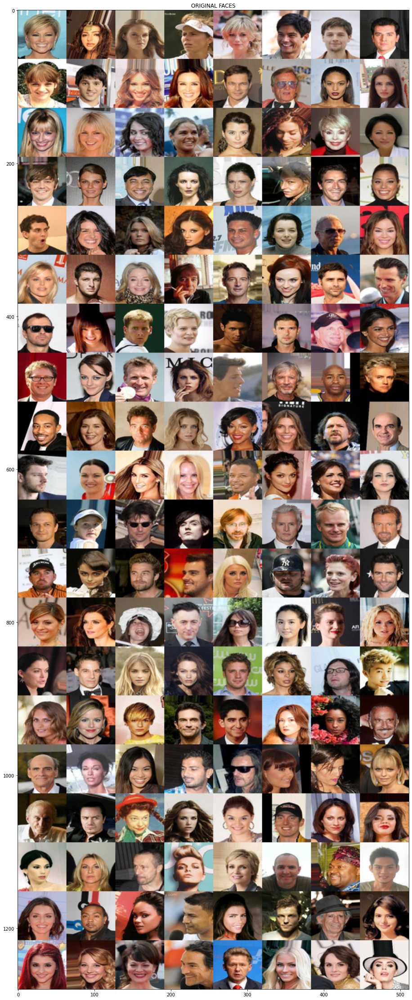

In [58]:
predictions = face_data[:200]
plot_images(20,8,predictions,"ORIGINAL FACES")

## RECONSTRUCTED FACES or COMPRESSED (*which tries to replicate the original images*)

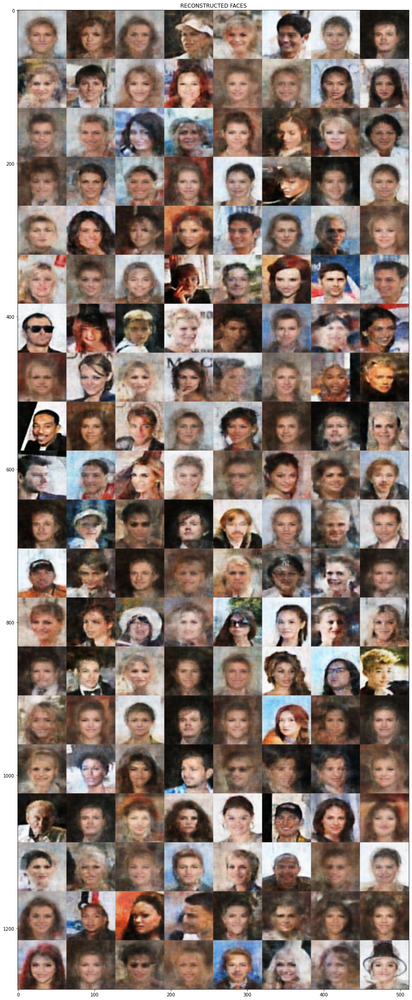

In [59]:
predictions  = vae.predict(face_data[:200])
plot_images(20,8,predictions, "RECONSTRUCTED FACES")

## NEWLY GENERATED FACES

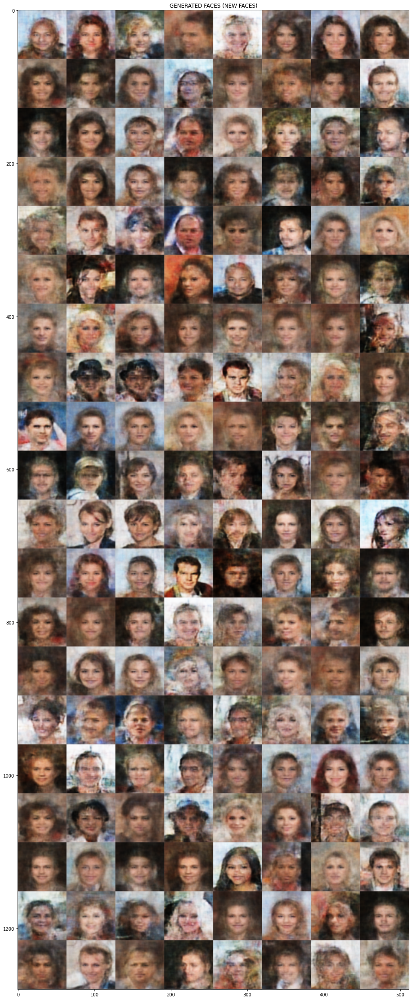

In [60]:
predictions= decoder.predict(np.random.randn(200, latent_dims))
plot_images(20,8,predictions, "GENERATED FACES (NEW FACES)")